# Gathering carpet image data

In [1]:
# Ignore the Warning Messages
import warnings
warnings.filterwarnings('ignore')

In [2]:
from glob import glob 
from PIL import Image


# Reflection on the approach of data gathering.

Scrapping based on keywords gathering carpet images will be a tedious and lengthy process. My previous search has shown that there is no publicly available carpet database; however, I can find websites displaying Azerbaijani carpets and scrape them directly than scrapping the wider net. After a bit of research, I have found a [website](http://www.azerbaijanrugs.com/guide/index.htm) hosting more than 2000 Azerbaijani and broader Caucasus/Persian region carpets categorized by carpet schools and regions. As manual download of 2000+ images will take "forever", I decided to write a script to automate the download process of the photos from this website directly. I used this [course](https://www.codecademy.com/learn/learn-web-scraping?g_network=g&g_device=c&g_adid=525668108565&g_keyword=python%20beautifulsoup%20tutorial&g_acctid=243-039-7011&g_adtype=search&g_campaign=US+Language%3A+Pro+-+Exact&g_keywordid=kwd-652592749664&g_campaignid=10030170700&g_adgroupid=102526217178&utm_id=t_kwd-652592749664:ag_102526217178:cp_10030170700:n_g:d_c&utm_term=python%20beautifulsoup%20tutorial&utm_campaign=US%20Language%3A%20Pro%20-%20Exact&utm_source=google&utm_medium=paid-search&utm_content=525668108565&hsa_acc=2430397011&hsa_cam=10030170700&hsa_grp=102526217178&hsa_ad=525668108565&hsa_src=g&hsa_tgt=kwd-652592749664&hsa_kw=python%20beautifulsoup%20tutorial&hsa_mt=e&hsa_net=adwords&hsa_ver=3&gclid=CjwKCAiAsYyRBhACEiwAkJFKouWNbtp0vrc8JBBEOSbqk29pzqfIB4TRgxO7VyHfHXVrFXY9M-yT2xoCFQMQAvD_BwE) to learn basics of how to scrap website and put together the algorithm. 

We can see that this approach is way more fruitful as we got just from one category 186 unique carpet images. Hence, by categorically scrapping this website, I can get 2000+ original high-quality carpet images which would be enough for the training of the GAN models with some additional techniques. 


## Data Gathering Caveats
During the data gatehring of the images, i have decided to exclude images which were in black/white coloring, severely damaged and blury as they would add noise to the data and can distort the models which will be applied onto them. 

In [3]:
import requests
import os
from tqdm import tqdm
from bs4 import BeautifulSoup as bs
from urllib.parse import urljoin, urlparse

In [4]:
def is_valid(url):
    """
        Checks if a given URL is valid.
    """
    parsed_url = urlparse(url)
    return bool(parsed_url.netloc) and bool(parsed_url.scheme)

In [5]:
# A core function that grabs all image URLs of a webpage

def grab_images(url):
    """
        Finds and gives back all image URLs on a given webpage
    """
    
    soup = bs(requests.get(url).content, "html.parser")
    
    urls = []
    
    # extract all img tags in HTML
    for img in tqdm(soup.find_all("img"), "Extracting images"):
        img_url = img.attrs.get("src")
        if not img_url:
            # if img does not contain src attribute => skip
            continue
        # make the URL absolute by joining domain with the URL that is just extracted
        img_url = urljoin(url, img_url)
        
        # remove HTTP GET key-value pairs
        try:
            pos = img_url.index("?")
            img_url = img_url[:pos]
        except ValueError:
            pass
        
        # check if the url is valid
        if is_valid(img_url):
            urls.append(img_url)
    return urls

In [6]:
def download(url, pathname):
    """
        Downloads a image given a URL and puts it in the selected folder  
    """
    # if path does not exist, make that path a new directory
    if not os.path.isdir(pathname):
        os.makedirs(pathname)
    # piece by piece download the body of response
    response = requests.get(url, stream=True)
    # get the total file size
    file_size = int(response.headers.get("Content-Length", 0))
    # get the file name
    filename = os.path.join(pathname, url.split("/")[-1])
    # progress bar, changing the unit to bytes instead of iteration (default by tqdm)
    progress = tqdm(response.iter_content(1024), f"Downloading {filename}", total=file_size, unit="B", unit_scale=True, unit_divisor=1024)
    with open(filename, "wb") as f:
        for data in progress.iterable:
            # write data read to the file
            f.write(data)
            # update the progress bar manually
            progress.update(len(data))
            

In [7]:
def main(url, path):
    # get all images
    imgs = grab_images(url)
    for img in imgs:
        # for each image, download it
        download(img, path)

# Scrapping Kuba Region Carpets

## 1. ANTIQUE CAUCASIAN AZERBAIJANI  SEYCHOUR / SEICHOUR RUGS AND CARPETS


I removed the loading code lines in further cells as I have to rerun the notebook sometimes when kernels dies out :) So, I'm just showing here how I have implemented laoding in first place. 

In [ ]:
for i in range(121):
    main(f"http://www.azerbaijanrugs.com/guide/kuba/kuba_rug{i}.htm", "kuba-syechour-carpets")
    

In [68]:
from matplotlib import pyplot as plt
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-syechour-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))
    
    
carpet_images_loaded = 0 
carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 224
The total number of all loaded images is: 224


We can see that this approach is way more fruitful as we got just from one category 225 unique carpet images. Hence, by categorically scrapping this website, I can get 2000+ original high-quality carpet images which would be enough for the training of the GAN models with some additional techniques. 

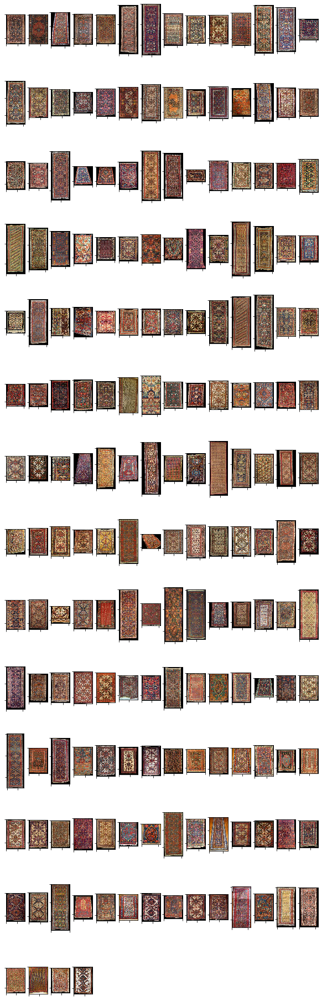

In [32]:
# Showing the images 
plt.figure(figsize=(14 * 14, 14 * 2)) 
plt.subplots_adjust(bottom=0, left=.01, right=.05, top=.90, hspace=.35)


for i, image in enumerate(images_left):
    plt.subplot(14, 14, i+1).set_yticklabels([])
    plt.subplot(14, 14, i+1).set_xticklabels([])
    plt.imshow(image)

## 2. ANTIQUE CAUCASIAN AZERBAIJANI  ALPAN RUGS AND CARPETS

In [69]:
# Checking the number of images loaded  
# Placeholder for all images

#placeholder for currently loaded images
images_loaded = []
for img_path in glob('kuba-alpan-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 138
The total number of all loaded images is: 362


## 3. ANTIQUE EASTERN AZERBAIJANI SOUMAK CARPETS


In [70]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-sumakh-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 191
The total number of all loaded images is: 553


## 4. ANTIQUE CAUCASIAN DRAGON SUMAKH RUGS, AZERBAIJAN


In [71]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-dragon-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 50
The total number of all loaded images is: 603


## 5. ANTIQUE CAUCASIAN KUBA KARAGASHLI RUGS AND CARPETS



In [72]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-karagashli-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 69
The total number of all loaded images is: 672


## 6. ANTIQUE CAUCASIAN EASTERN AZERBAIJANI  MEDALLION & GUBBA (GUBPA) RUGS AND CARPETS



In [73]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-shirvan-medallion-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 231
The total number of all loaded images is: 903


## 7. ANTIQUE CAUCASIAN KUBA SUNBURST ZEJWA RUGS AND CARPETS



In [74]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-zejwa-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 52
The total number of all loaded images is: 955


## 8. ANTIQUE KUBA FLORAL & HERALDIC PALMETTE PATTERN RUGS AND CARPETS ("MOLLA KAMALLY" DESIGN), AZERBAIJAN



In [75]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-molla_kamalli-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 10
The total number of all loaded images is: 965


## 9. ANTIQUE CAUCASIAN KUBA PIREBEDIL / PEREPEDIL RUGS



In [76]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-perepedill-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 71
The total number of all loaded images is: 1036


## 10. ANTIQUE CAUCASIAN KUBA SYRT CHICHI AND KHYRDAGUL CHICHI PRAYER RUGS AND CARPETS



In [77]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-chichi-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 131
The total number of all loaded images is: 1167


## 11. ANTIQUE CAUCASIAN KUBA GOLLU CHICHI RUGS AND CARPETS, AZERBAIJAN



In [78]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-gollu-chichi-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 40
The total number of all loaded images is: 1207


## 12. ANTIQUE CAUCASIAN KUBA RUGS AND CARPETS (various/uncategorized)


In [79]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-other-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 206
The total number of all loaded images is: 1413


## 13. ANTIQUE CAUCASIAN AZERBAIJANI  KUBA LATTICE FIELD RUGS AND CARPETS



In [80]:
# Checking the number of images loaded  
# Placeholder for images
from matplotlib import pyplot as plt
images_loaded = []
for img_path in glob('kuba-tekye-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 176
The total number of all loaded images is: 1589


## 14. ANTIQUE CAUCASIAN AZERBAIJANI  ZEYVE (ALSO MISTAKENLY NAMED AS LESGHI STAR) RUGS AND CARPETS



In [81]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-zeyve-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 215
The total number of all loaded images is: 1804


## 15. ANTIQUE KUBA "PALMETTE AND CURLED LEAF" MOTIF RUGS AND CARPETS (SO CALLED "KUBA BIDJOV" RUGS), AZERBAIJAN



In [82]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-biliji-lajadi-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 52
The total number of all loaded images is: 1856


## 16. ANTIQUE CAUCASIAN EASTERN AZERBAIJANI (KUBA, BAKU, SHIELD) SHIELD RUGS AND CARPETS



In [83]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-shield-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 98
The total number of all loaded images is: 1954


## 17. ANTIQUE CAUCASIAN KUBA AFSHAN RUGS AND CARPETS (SO CALLED "UGAH" VERSION)



In [84]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-afshan-ugah-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 37
The total number of all loaded images is: 1991


## 18. ANTIQUE CAUCASIAN EASTERN AZERBAIJAN AFSHAN RUGS AND CARPETS



In [85]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-afshan-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 142
The total number of all loaded images is: 2133


## 19. ANTIQUE KUBA AFURJA RUGS AND CARPETS, AZERBAIJAN



In [86]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-afurja-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 18
The total number of all loaded images is: 2151


## 20. ANTIQUE KUBA HAJI GAIB RUGS AND CARPETS, AZERBAIJAN



In [87]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-hajigaib-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 29
The total number of all loaded images is: 2180


## 21. ANTIQUE KUBA GRYZ & JEK RUGS AND CARPETS, MOUNTAINOUS KUBA REGION, AZERBAIJAN



In [88]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-gyryz-jek-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 22
The total number of all loaded images is: 2202


## 22. ANTIQUE CAUCASIAN KONAGKEND RUGS AND CARPETS, AZERBAIJAN



In [89]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-konagkend-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 19
The total number of all loaded images is: 2221


## 23. ANTIQUE KUBA PALMETTE RUGS AND CARPETS ("YERFI" DESIGN), AZERBAIJAN



In [90]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-yerfi-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 6
The total number of all loaded images is: 2227


## 24. ANTIQUE KUBA FLOWERING SHRUBS (SALMA SÖYÜD) RUGS AND CARPETS, AZERBAIJAN


In [91]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-salmasoyud-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 18
The total number of all loaded images is: 2245


## 25. ANTIQUE AZERBAIJANI CAUCASIAN KUBA KILIMS



In [92]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-kilim-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 27
The total number of all loaded images is: 2272


## 26. ANTIQUE KUBA GYMYL RUGS AND CARPETS, AZERBAIJAN



In [93]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kuba-gymyl-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 45
The total number of all loaded images is: 2317


# Scrapping Carpets from Baku region

## 1. ANTIQUE BAKU KHILA BUTA (BOTEH) RUG

In [8]:
links_buta = ["http://www.azerbaijanrugs.com/guide/baku/khila-boteh/antique-baku-khila-buta-carpet-azerbaijan-carpet-museum.htm",
             "http://www.azerbaijanrugs.com/guide/baku/khila-boteh/antique-baku-khila-buta-carpet-LaTorre-Alberto_Boralevi-Splendori_di_Citta.htm",
             "http://www.azerbaijanrugs.com/guide/baku/khila-boteh/antique_baku_khila_boteh_rug-rippon_boswell-11-2006-L61.htm",
             "http://www.azerbaijanrugs.com/guide/baku/khila-boteh/antique-baku-khila-buta-carpet-ian-bennett-oriental-rug-p290.htm",
             "http://www.azerbaijanrugs.com/guide/baku/khila-boteh/antique_baku_khila_boteh1.htm",
             "http://www.azerbaijanrugs.com/guide/baku/khila-boteh/antique-baku-khila-buta-carpet-Murray-Eiland-p282.htm"]


for i in range(len(links_buta)):
    main(links_buta[i], "antique-baku-khila-buta-carpet")
    

Extracting images: 100%|██████████| 2/2 [00:00<00:00, 7043.33it/s]


In [95]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('antique-baku-khila-buta-carpet/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# baku carpet count
baku_carpets = 0
baku_carpets = len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Baku loaded images is:", baku_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)


The number of loaded images is: 8
The total number of Baku loaded images is: 8
The total number of all loaded images is: 2325


## 2. ANTIQUE BAKU SURAHANI / SURAKHANI RUGS

In [97]:
for i in range(3):
    main(f"http://www.azerbaijanrugs.com/guide/baku/surakhani/antique_surakhani_baku_rug{i}.htm", "antique-surakhani-baku-carpets")
    

Extracting images: 100%|██████████| 2/2 [00:00<00:00, 6246.17it/s]


In [99]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('antique-surakhani-baku-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# baku carpet count
baku_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Baku loaded images is:", baku_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 2
The total number of Baku loaded images is: 18
The total number of all loaded images is: 2335


## 3. ANTIQUE SHIELD BAKU RUGS

In [100]:
for i in range(8):
    main(f"http://www.azerbaijanrugs.com/guide/baku/shield-baku/antique_shield_baku_rug{i}.htm", "antique-shield-baku-carpets")
    

Extracting images: 100%|██████████| 2/2 [00:00<00:00, 6825.56it/s]


In [101]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('antique-shield-baku-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# baku carpet count
baku_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Baku loaded images is:", baku_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 7
The total number of Baku loaded images is: 25
The total number of all loaded images is: 2342


## 4. EARLY BAKU RUGS AND CARPETS

In [115]:
for i in range(2):
    main(f"http://www.azerbaijanrugs.com/guide/baku/antique-baku-rugs-various/antique_baku_rug4_sothebysL05870_L25.htm", "early-antique-baku-carpets")
    





Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]



Extracting images: 100%|██████████| 2/2 [00:00<00:00, 3839.18it/s]







































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]



Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2873.80it/s]





































In [114]:
for i in range(5):
    main(f"http://www.azerbaijanrugs.com/guide/baku/antique-baku-rugs-various/antique_baku_rug{i}.htm", "early-antique-baku-carpets")
    




Extracting images:   0%|          | 0/1 [00:00<?, ?it/s]


Extracting images: 100%|██████████| 1/1 [00:00<00:00, 1375.63it/s]








Extracting images:   0%|          | 0/4 [00:00<?, ?it/s]


Extracting images: 100%|██████████| 4/4 [00:00<00:00, 4700.82it/s]

































































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]



Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2751.27it/s]







































Extracting images:   0%|          | 0/3 [00:00<?, ?it/s]



Extracting images: 100%|██████████| 3/3 [00:00<00:00, 4088.02it/s]






















































Extracting images:   0%|          | 0/1 [00:00<?, ?it/s]



Extracting images: 100%|██████████| 1/1 [00:00<00:00, 1230.00it/s]












In [103]:
for i in range(5):
    main(f"http://www.azerbaijanrugs.com/guide/baku/antique-baku-rugs-various/antique_baku_rug{i}.htm", "early-antique-baku-carpets")
    

Extracting images: 100%|██████████| 1/1 [00:00<00:00, 3847.99it/s]


In [108]:
nums = [14, 107, 99,73,71,58, 88, 117, 100, 38, 18, 59, 65, 63, 86, 84]
for i in nums:
    main(f"http://www.azerbaijanrugs.com/guide/kuba/kuba-afshan/antique_caucasian_kuba_baku_afshan_rug{i}.htm", "early-antique-baku-carpets")
    


Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2509.31it/s]

Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]

Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2648.76it/s]















Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]

Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2584.29it/s]
















Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]

Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2809.31it/s]















Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]

Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2620.62it/s]
















Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]

Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2848.42it/s]















Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]

Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2370.33it/s]











Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]

Extracting images: 100%|██████████|

In [119]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('early-antique-baku-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# baku carpet count
baku_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Baku loaded images is:", baku_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 25
The total number of Baku loaded images is: 68
The total number of all loaded images is: 2385


## 5. ANTIQUE BAKU VILLAGE RUGS

In [111]:
for i in range(7):
    main(f"http://www.azerbaijanrugs.com/guide/baku/village-rugs/antique_baku_village_rug{i}.htm", "baku-village-carpets")
    




Extracting images:   0%|          | 0/1 [00:00<?, ?it/s]


Extracting images: 100%|██████████| 1/1 [00:00<00:00, 1923.11it/s]








Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]


Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2358.34it/s]


































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]


Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2375.03it/s]
































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]


Extracting images: 100%|██████████| 2/2 [00:00<00:00, 1273.90it/s]


























Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]


Extracting images: 100%|██████████| 2/2 [00:00<00:00, 3816.47it/s]




















Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]


Extracting images: 100%|██████████| 2/2 [00:00<00:00, 3344.74it/s]
























Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]


Extracting images: 100%|██████████| 2/

In [112]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('baku-village-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# baku carpet count
baku_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Baku loaded images is:", baku_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 6
The total number of Baku loaded images is: 55
The total number of all loaded images is: 2372


## 6. ANTIQUE BAKU RUGS WITH OCTAGONAL MEDALLIONS

In [116]:
for i in range(7):
    main(f"http://www.azerbaijanrugs.com/guide/baku/medallion-rugs/antique_baku_medallion_rug{i}.htm", "baku-medallion-carpets")
    






Extracting images:   0%|          | 0/1 [00:00<?, ?it/s]




Extracting images: 100%|██████████| 1/1 [00:00<00:00, 1375.63it/s]
















Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]




Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2389.92it/s]
















































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]




Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2538.16it/s]












































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]




Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2746.76it/s]












































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]




Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2600.31it/s]




















































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]




Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2234.58it/s]

























In [120]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('baku-medallion-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# baku carpet count
baku_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Baku loaded images is:", baku_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 6
The total number of Baku loaded images is: 68
The total number of all loaded images is: 2385


# ANTIQUE AZERBAIJANI CAUCASIAN SHIRVAN RUGS AND CARPETS 


## 1. ANTIQUE SHIRVAN "AKSTAFA BIRD" (SALYAN QUSHLU) RUGS AND CARPETS



In [121]:
for i in range(80):
    main(f"http://www.azerbaijanrugs.com/guide/shirvan/akstafa/antique_caucasian_akstafa_saliani_rug{i}.htm", "shirvan-akstafa-carpets")
    







Extracting images: 0it [00:00, ?it/s]





Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]





Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2389.92it/s]














































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]






Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2237.56it/s]








































































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]






Extracting images: 100%|██████████| 2/2 [00:00<00:00, 3592.55it/s]




















































































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]






Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2570.83it/s]




























































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]






Extracting images: 100%|██████████| 2/2 [00:00<00:00, 3383.87it/s]










































In [124]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('shirvan-akstafa-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# shirvan carpet count
shirvan_carpets = 0
shirvan_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Shirvan loaded images is:", shirvan_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 98
The total number of Shirvan loaded images is: 98
The total number of all loaded images is: 2483


## 2. ANTIQUE SHIRVAN SALYAN / SALIANI RUGS AND CARPETS



In [126]:
for i in range(60):
    main(f"http://www.azerbaijanrugs.com/guide/shirvan/saliani/antique_caucasian_saliani_rug{i}.htm", "shirvan-saliani-carpets")
    

























Extracting images: 0it [00:00, ?it/s]























Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]























Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2580.32it/s]


















































































































































































































































































































































































































































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]























Extracting images: 100%|██████████| 2/2 [00:00<00:00, 3096.57it/s]





























































































































































































In [127]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('shirvan-saliani-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# shirvan carpet count
shirvan_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Shirvan loaded images is:", shirvan_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 59
The total number of Shirvan loaded images is: 157
The total number of all loaded images is: 2542


## 3. ANTIQUE "AKSTAFA" / SALYAN PRAYER RUGS



In [128]:
for i in range(88):
    main(f"http://www.azerbaijanrugs.com/guide/shirvan/akstafa-prayer/antique_caucasian_akstafa_prayer_rug{i}.htm", "shirvan-akstafa-prayer-carpets")
    



































Extracting images: 0it [00:00, ?it/s]

































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]

































Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2621.44it/s]















































































































































































































































































































































































































































































































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]

































Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2691.24it/s]
























































































In [129]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('shirvan-akstafa-prayer-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# shirvan carpet count
shirvan_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Shirvan loaded images is:", shirvan_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 76
The total number of Shirvan loaded images is: 233
The total number of all loaded images is: 2618


## 4. ANTIQUE SHIRVAN RUGS WITH STAR MEDALLIONS



In [130]:
for i in range(21):
    main(f"http://www.azerbaijanrugs.com/guide/shirvan/shirvan-star/antique_caucasian_shirvan_star_rug{i}.htm", "shirvan-star-carpets")
    












































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]










































Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2349.75it/s]
























































































































































































































































































































































































































































































































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]










































Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2489.94it/s]



























































































































In [132]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('shirvan-star-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# shirvan carpet count
shirvan_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Shirvan loaded images is:", shirvan_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 21
The total number of Shirvan loaded images is: 254
The total number of all loaded images is: 2639


## 5. Early Shirvan rugs

In [133]:
for i in range(32):
    main(f"http://www.azerbaijanrugs.com/guide/shirvan/early-shirvan/early_shirvan_rug{i}.htm", "early-shirvan-carpets")
    














































Extracting images: 0it [00:00, ?it/s]












































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]












































Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2231.61it/s]




























































































































































































































































































































































































































































































































































































Extracting images:   0%|          | 0/4 [00:00<?, ?it/s]












































Extracting images: 100%|████████

In [134]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('early-shirvan-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# shirvan carpet count
shirvan_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Shirvan loaded images is:", shirvan_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 38
The total number of Shirvan loaded images is: 292
The total number of all loaded images is: 2677


## 6. Antique Shirvan Shield rugs

In [135]:
for i in range(38):
    main(f"http://www.azerbaijanrugs.com/guide/shirvan/shirvan-shield/antique_caucasian_shirvan_shield_rug{i}.htm", "shirvan-shield-carpets")
    




















































Extracting images: 0it [00:00, ?it/s]


















































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]


















































Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2121.01it/s]

















































































































































































































































































































































































































































































































































































































































































































In [136]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('shirvan-shield-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# shirvan carpet count
shirvan_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Shirvan loaded images is:", shirvan_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 39
The total number of Shirvan loaded images is: 331
The total number of all loaded images is: 2716


## 7. Antique Shirvan Kilims 

In [137]:
for i in range(160):
    main(f"http://www.azerbaijanrugs.com/guide/shirvan/kilims/antique_caucasian_shirvan_kilim{i}.htm", "shirvan-kilim-carpets")
    




























































Extracting images: 0it [00:00, ?it/s]


























































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]


























































Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2188.52it/s]






























































































































































































































































































































































































































































































































































































































































Extracting images:   0%| 

In [138]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('shirvan-kilim-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# shirvan carpet count
shirvan_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Shirvan loaded images is:", shirvan_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 179
The total number of Shirvan loaded images is: 510
The total number of all loaded images is: 2895


## 8. Antique Shirvan Kabistan ("Marasali") Prayer rugs

In [139]:
for i in range(150):
    main(f"http://www.azerbaijanrugs.com/guide/shirvan/kabistan/antique_caucasian_shirvan_kabistan_rug{i}.htm", "shirvan-kabistan-carpets")
    












































































Extracting images: 0it [00:00, ?it/s]










































































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]










































































Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2360.99it/s]









































































































































































































































































































































































































































































































































































































































In [141]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('shirvan-kabistan-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# shirvan carpet count
shirvan_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Shirvan loaded images is:", shirvan_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 93
The total number of Shirvan loaded images is: 603
The total number of all loaded images is: 2988


## 9. Antique Shirvan Bijo rugs

In [142]:
for i in range(30):
    main(f"http://www.azerbaijanrugs.com/guide/shirvan/bidjov/antique_caucasian_shirvan_bidjov_rug{i}.htm", "shirvan-bidjov-carpets")
    




























































































Extracting images: 0it [00:00, ?it/s]


























































































Extracting images:   0%|          | 0/3 [00:00<?, ?it/s]


























































































Extracting images: 100%|██████████| 3/3 [00:00<00:00, 4242.38it/s]

























































































































































































































































































































































































































































































































































































In [144]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('shirvan-bidjov-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# shirvan carpet count
shirvan_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Shirvan loaded images is:", shirvan_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 31
The total number of Shirvan loaded images is: 634
The total number of all loaded images is: 3019


## 10. Antique Shirvan Pictorial rugs

In [143]:
for i in range(48):
    main(f"http://www.azerbaijanrugs.com/guide/shirvan/pictorial/antique_caucasian_shirvan_pictorial_rug{i}.htm", "shirvan-pictorial-carpets")
    

































































































Extracting images: 0it [00:00, ?it/s]































































































Extracting images: 0it [00:00, ?it/s]































































































Extracting images: 0it [00:00, ?it/s]































































































Extracting images: 0it [00:00, ?it/s]































































































Extracting images:   0%|          | 0/3 [00:00<?, ?it/s]































































































Extracting images: 100%|██████████| 3/3 [00:00<00:00, 3371.63it/s]



























































































































































In [147]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('shirvan-pictorial-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# shirvan carpet count
shirvan_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Shirvan loaded images is:", shirvan_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 24
The total number of Shirvan loaded images is: 658
The total number of all loaded images is: 3043


## 11.  Antique Shirvan Prayer rugs with various designs (~130 rugs displayed)

In [148]:
for i in range(130):
    main(f"http://www.azerbaijanrugs.com/guide/shirvan/prayer-rugs/antique_caucasian_shirvan_prayer_rug{i}.htm", "shirvan-prayer-various-carpets")
    





































































































Extracting images: 0it [00:00, ?it/s]



































































































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]



































































































Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2528.21it/s]






























































































































































































































































































































































































































































































































































In [161]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('shirvan-prayer-various-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# shirvan carpet count
shirvan_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Shirvan loaded images is:", shirvan_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 127
The total number of Shirvan loaded images is: 785
The total number of all loaded images is: 3170


## 12. Antique Shirvan Marasali rugs (~160 antique Marasali rugs are exhibited)

In [149]:
for i in range(160):
    main(f"http://www.azerbaijanrugs.com/guide/shirvan/marasali/antique_caucasian_shirvan_marasali_prayer_rug{i}.htm", "shirvan-marasali-carpets")
    



















































































































Extracting images: 0it [00:00, ?it/s]

















































































































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]

















































































































Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2275.19it/s]




















































































































































































































































































































































































































































































































In [162]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('shirvan-marasali-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# shirvan carpet count
shirvan_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Shirvan loaded images is:", shirvan_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 108
The total number of Shirvan loaded images is: 893
The total number of all loaded images is: 3278


# ANTIQUE NAKHCHIVAN RUGS AND FLATWEAVES

In [25]:
for i in range(10):
    main(f"http://www.azerbaijanrugs.com/guide/nakhchivan/antique_nakhchivan_shadda{i}.htm", "nakhchivan-carpets")
    

Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 2/2 [00:00<00:00, 6759.56it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]


In [30]:
from matplotlib import pyplot as plt 
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('nakhchivan-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# nakhchivan carpet count
nakhchivan_carpets = 0
nakhchivan_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Nakhchivan loaded images is:", nakhchivan_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 34
The total number of Nakhchivan loaded images is: 34
The total number of all loaded images is: 3346


# ANTIQUE GANJA (GENJE, GENDJE, GENDGE) RUGS - "ANCIENT GANJA" DESIGN

In [31]:
for i in range(40):
    main(f"http://www.azerbaijanrugs.com/guide/ganja/ancient-ganja/antique_caucasian_ganja_ancient_ganja_rug{i}.htm", "ganja-carpets")
    

Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 1/1 [00:00<00:00, 4258.18it/s]


In [44]:
from matplotlib import pyplot as plt 
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('ganja-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# ganja carpet count
ganja_carpets = 0
ganja_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Ganja loaded images is:", ganja_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 62
The total number of Ganja loaded images is: 62
The total number of all loaded images is: 3408


# ANTIQUE AZERBAIJANI CAUCASIAN KAZAK RUGS AND CARPETS

I have added manually 19 images to the folder from http://www.qazax.net/en/carpets.htm

In [59]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('qazax-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# qazax carpet count
qazax_carpets = 0
qazax_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Qazax loaded images is:", qazax_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 19
The total number of Qazax loaded images is: 19
The total number of all loaded images is: 3427


## 1. EARLY KAZAK RUGS



In [67]:
for i in range(2):
    main(f"http://www.azerbaijanrugs.com/guide/kazak/various/antique_caucasian_kazak_rug204.htm", "early-qazax-carpets")
    

Extracting images: 100%|██████████| 2/2 [00:00<00:00, 7781.64it/s]


In [68]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('early-qazax-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# qazax carpet count
qazax_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Qazax loaded images is:", qazax_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 19
The total number of Qazax loaded images is: 19
The total number of all loaded images is: 3446


## 2. ANTIQUE STAR KAZAK / SHIKHLI RUGS AND CARPETS, AZERBAIJAN


In [70]:
for i in range(40):
    main(f"http://www.azerbaijanrugs.com/guide/kazak/star-kazak/antique_caucasian_star_kazak_rug{i}.htm", "star-qazax-carpets")
    

Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 2/2 [00:00<00:00, 6154.52it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]


In [72]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('star-qazax-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# qazax carpet count
qazax_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Qazax loaded images is:", qazax_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 53
The total number of Qazax loaded images is: 91
The total number of all loaded images is: 3499


## 3. ANTIQUE KAZAK KARACHOP RUGS AND CARPETS


In [73]:
for i in range(121):
    main(f"http://www.azerbaijanrugs.com/guide/kazak/karachop/antique_caucasian_kazak_karachop_rug{i}.htm", "karachop-qazax-carpets")
    

Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 2/2 [00:00<00:00, 5899.16it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 2/2 [00:00<00:00, 6853.44it/s]


In [76]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('karachop-qazax-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# qazax carpet count
qazax_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Qazax loaded images is:", qazax_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 143
The total number of Qazax loaded images is: 234
The total number of all loaded images is: 3642


## 4. ANTIQUE KAZAK PRAYER RUGS



In [77]:
for i in range(50):
    main(f"http://www.azerbaijanrugs.com/guide/kazak/prayer-rugs/antique_caucasian_kazak_prayer_rug{i}.htm", "prayer-qazax-carpets")
    

Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 2/2 [00:00<00:00, 7275.46it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 2/2 [00:00<00:00, 7269.16it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 2/2 [00:00<00:00, 7019.76it/s]


In [79]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('prayer-qazax-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# qazax carpet count
qazax_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Qazax loaded images is:", qazax_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 52
The total number of Qazax loaded images is: 286
The total number of all loaded images is: 3694


## 5. ANTIQUE KAZAK RUGS WITH THE "TURTLE" MEDALLIONS


In [80]:
for i in range(25):
    main(f"http://www.azerbaijanrugs.com/guide/kazak/turtle/antique_caucasian_kazak_turtle_rug{i}.htm", "turtle-qazax-carpets")
    

Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 3/3 [00:00<00:00, 10565.00it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 1/1 [00:00<00:00, 4324.02it/s]


In [81]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('turtle-qazax-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# qazax carpet count
qazax_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Qazax loaded images is:", qazax_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 25
The total number of Qazax loaded images is: 311
The total number of all loaded images is: 3719


## 6. ANTIQUE SHIELD KAZAK RUGS



In [82]:
for i in range(120):
    main(f"http://www.azerbaijanrugs.com/guide/kazak/shield-kazak/antique_caucasian_shield_kazak_rug{i}.htm", "shield-qazax-carpets")
    

Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 1/1 [00:00<00:00, 3675.99it/s]


In [83]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('shield-qazax-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# qazax carpet count
qazax_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Qazax loaded images is:", qazax_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 122
The total number of Qazax loaded images is: 433
The total number of all loaded images is: 3841


## 7. ANTIQUE KAZAK / GENDJE / BORDJALOU DISTRICTS "CHAJLI" RUGS



In [84]:
for i in range(20):
    main(f"http://www.azerbaijanrugs.com/guide/kazak/chajli/antique_caucasian_kazak_chajli_rug{i}.htm", "chajli-qazax-carpets")
    

Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 1/1 [00:00<00:00, 6297.75it/s]


In [85]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('chajli-qazax-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# qazax carpet count
qazax_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Qazax loaded images is:", qazax_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 16
The total number of Qazax loaded images is: 449
The total number of all loaded images is: 3857


## 8. ANTIQUE KAZAK RUGS WITH MOGHAN (MEMLING) GULS


In [86]:
for i in range(80):
    main(f"http://www.azerbaijanrugs.com/guide/kazak/kazak-moghan/antique_caucasian_kazak_moghan_rug{i}.htm", "moghan-qazax-carpets")
    

Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 2/2 [00:00<00:00, 6944.21it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 2/2 [00:00<00:00, 8507.72it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 1/1 [00:00<00:00, 4310.69it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 2/2 [00:00<00:00, 5919.98it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 1/1 [00:00<00:00, 3876.44it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]


In [87]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('moghan-qazax-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# qazax carpet count
qazax_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Qazax loaded images is:", qazax_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 62
The total number of Qazax loaded images is: 511
The total number of all loaded images is: 3919


## 9. ANTIQUE KAZAK KILIMS (Gazakh Kilimleri, Gazakh qezasi (uyzed), Elisabethpol (Gendje) Governate, late 19th-early 20th centuries)



In [88]:
for i in range(30):
    main(f"http://www.azerbaijanrugs.com/guide/kazak/kilims/antique_caucasian_kazak_kilim{i}.htm", "kilims-qazax-carpets")
    

Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 2/2 [00:00<00:00, 6507.84it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]


In [89]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kilims-qazax-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# qazax carpet count
qazax_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Qazax loaded images is:", qazax_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 36
The total number of Qazax loaded images is: 547
The total number of all loaded images is: 3955


## 10. ANTIQUE KAZAK RUGS WITH THE RAMS HORN MOTIF (BORDJALOU RAMS HORN RUGS ARE NOT INCLUDED HERE)


In [90]:
for i in range(20):
    main(f"http://www.azerbaijanrugs.com/guide/kazak/rams-horn/antique_caucasian_kazak_rams_horn_rug{i}.htm", "rams-horn-qazax-carpets")
    

Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 1/1 [00:00<00:00, 2409.13it/s]


In [91]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('rams-horn-qazax-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# qazax carpet count
qazax_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Qazax loaded images is:", qazax_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 13
The total number of Qazax loaded images is: 560
The total number of all loaded images is: 3968


## 11. ANTIQUE KAZAK KARVANSARAY RUGS


In [92]:
for i in range(4):
    main(f"http://www.azerbaijanrugs.com/guide/kazak/karavansaray/antique_caucasian_kazak_karavansaray_rug{i}.htm", "karavansaray-qazax-carpets")
    

Extracting images: 100%|██████████| 2/2 [00:00<00:00, 4619.28it/s]


In [93]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('karavansaray-qazax-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# qazax carpet count
qazax_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Qazax loaded images is:", qazax_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 3
The total number of Qazax loaded images is: 563
The total number of all loaded images is: 3971


## 12. ANTIQUE TOVUZ (TAUS) RUGS, SHAMSHADDIL DISTRICT, AZERBAIJAN


In [94]:
for i in range(40):
    main(f"http://www.azerbaijanrugs.com/guide/kazak/tovuz/antique_caucasian_kazak_tovuz_rug{i}_taus.htm", "tovuz-qazax-carpets")
    

Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 1/1 [00:00<00:00, 2513.06it/s]


In [96]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('tovuz-qazax-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# qazax carpet count
qazax_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Qazax loaded images is:", qazax_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 46
The total number of Qazax loaded images is: 609
The total number of all loaded images is: 4017


## 13. ANTIQUE KAZAK AND GENDJE RUGS WITH "AKSTAFA BIRD" DESIGN


In [95]:
for i in range(12):
    main(f"http://www.azerbaijanrugs.com/guide/kazak/akstafa/antique_caucasian_kazak_akstafa_rug{i}.htm", "akstafa-qazax-carpets")
    

Extracting images: 100%|██████████| 3/3 [00:00<00:00, 14997.51it/s]


In [97]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('akstafa-qazax-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# qazax carpet count
qazax_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Qazax loaded images is:", qazax_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 13
The total number of Qazax loaded images is: 622
The total number of all loaded images is: 4030


## 14. ANTIQUE KAZAK RUGS WITH VARIOUS DESIGNS

In [98]:
for i in range(400):
    main(f"http://www.azerbaijanrugs.com/guide/kazak/various/antique_caucasian_kazak_rug{i}.htm", "various-qazax-carpets")
    

Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 2/2 [00:00<00:00, 3839.18it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 1/1 [00:00<00:00, 4198.50it/s]


In [99]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('various-qazax-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# qazax carpet count
qazax_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Qazax loaded images is:", qazax_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 394
The total number of Qazax loaded images is: 1016
The total number of all loaded images is: 4424


# ANTIQUE AZERBAIJANI CAUCASIAN KARABAGH RUGS AND CARPETS


## 1. EARLY AZERBAIJAN CARPETS


In [100]:
for i in range(310):
    main(f"http://www.azerbaijanrugs.com/guide/karabagh/early-karabagh/early_karabagh_rug{i}.htm", "early-karabagh-carpets")
    

Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 2/2 [00:00<00:00, 7550.50it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 2/2 [00:00<00:00, 4862.96it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 2/2 [00:00<00:00, 5436.56it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 3/3 [00:00<00:00, 9962.72it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting

In [107]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('early-karabagh-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# karabagh carpet count
karabagh_carpets = 0
karabagh_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Karabagh loaded images is:", karabagh_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 109
The total number of Karabagh loaded images is: 109
The total number of all loaded images is: 4533


## 2. ANTIQUE SUNBURST KARABAGH ÇELEBI/ CHELABERD (CHILABÖRD) / "EAGLE KAZAK" / "ADLER KAZAK" RUGS. AZERBAIJAN



In [105]:
for i in range(2):
    main(f"http://www.azerbaijanrugs.com/guide/karabagh/chelaberd/antique_caucasian_karabagh_chelaberd_eagle_adler_kazak_rug4.htm", "chelaberd-karabagh-carpets")
    

Extracting images: 100%|██████████| 2/2 [00:00<00:00, 7724.32it/s]


In [108]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('chelaberd-karabagh-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# Karabagh carpet count
karabagh_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Karabagh loaded images is:", karabagh_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 37
The total number of Karabagh loaded images is: 146
The total number of all loaded images is: 4570


## 3. ANTIQUE KARABAGH CLOUDBAND RUGS



In [106]:
for i in range(64):
    main(f"http://www.azerbaijanrugs.com/guide/karabagh/cloudband/antique_caucasian_karabagh_cloudband_rug{i}.htm", "cloudband-karabagh-carpets")
    

Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 4/4 [00:00<00:00, 12043.95it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 3/3 [00:00<00:00, 9532.51it/s]


In [110]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('cloudband-karabagh-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# Karabagh carpet count
karabagh_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Karabagh loaded images is:", karabagh_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 59
The total number of Karabagh loaded images is: 205
The total number of all loaded images is: 4629


## 4. ANTIQUE KARABAGH KASIM USHAG RUGS


In [109]:
for i in range(80):
    main(f"http://www.azerbaijanrugs.com/guide/karabagh/kasim-ushag/antique_caucasian_karabagh_kasim_ushag_rug{i}.htm", "kasim-ushag-karabagh-carpets")
    

Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 2/2 [00:00<00:00, 7760.04it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 2/2 [00:00<00:00, 10578.32it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 2/2 [00:00<00:00, 7163.63it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 1/1 [00:00<00:00, 3953.16it/s]


In [125]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('kasim-ushag-karabagh-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# Karabagh carpet count
karabagh_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Karabagh loaded images is:", karabagh_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 75
The total number of Karabagh loaded images is: 280
The total number of all loaded images is: 4704


## 5. ANTIQUE KARABAGH PICTORIAL RUGS



In [111]:
for i in range(32):
    main(f"http://www.azerbaijanrugs.com/guide/karabagh/pictorial/antique_caucasian_karabagh_pictorial_rug{i}.htm", "pictorial-karabagh-carpets")
    

Extracting images: 0it [00:00, ?it/s]
Extracting images: 100%|██████████| 1/1 [00:00<00:00, 4064.25it/s]


In [126]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('pictorial-karabagh-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# Karabagh carpet count
karabagh_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Karabagh loaded images is:", karabagh_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 15
The total number of Karabagh loaded images is: 295
The total number of all loaded images is: 4719


## 6. ANTIQUE KARABAGH "GORADIS" (HORADIS) RUGS



In [112]:
for i in range(20):
    main(f"http://www.azerbaijanrugs.com/guide/karabagh/goradis/antique_caucasian_karabagh_goradis_rug{i}.htm", "goradis-karabagh-carpets")
    

Extracting images: 100%|██████████| 2/2 [00:00<00:00, 6716.26it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]
Extracting images: 0it [00:00, ?it/s]


In [127]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('goradis-karabagh-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# Karabagh carpet count
karabagh_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Karabagh loaded images is:", karabagh_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 12
The total number of Karabagh loaded images is: 307
The total number of all loaded images is: 4731


## 7. ANTIQUE KARABAGH PRAYER RUGS (NAMAZLYG)



In [114]:
for i in range(20):
    main(f"http://www.azerbaijanrugs.com/guide/karabagh/prayer-rugs/antique_caucasian_karabagh_prayer_rug{i}.htm", "prayer-karabagh-carpets")
    


Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2134.51it/s]

Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]

Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2648.76it/s]
















Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]

Extracting images: 100%|██████████| 2/2 [00:00<00:00, 3495.25it/s]
















Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]

Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2710.37it/s]












Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]

Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2663.05it/s]

















Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]


Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2522.13it/s]
































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]


Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2877.74it/s]


































Extracting images:   0%|          | 0/2 [00:00<?, ?i

In [128]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('prayer-karabagh-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# Karabagh carpet count
karabagh_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Karabagh loaded images is:", karabagh_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 12
The total number of Karabagh loaded images is: 319
The total number of all loaded images is: 4743


## 8. ANTIQUE KARABAGH MOGHAN RUGS



In [115]:
for i in range(40):
    main(f"http://www.azerbaijanrugs.com/guide/karabagh/moghan/antique_caucasian_karabagh_moghan_rug{i}.htm", "moghan-karabagh-carpets")
    





Extracting images: 0it [00:00, ?it/s]



Extracting images:   0%|          | 0/3 [00:00<?, ?it/s]



Extracting images: 100%|██████████| 3/3 [00:00<00:00, 3359.92it/s]


























































































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]



Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2736.01it/s]



































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]



Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2816.86it/s]













































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]



Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2877.74it/s]







































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]



Extracting images: 100%|██████████| 2/2 [00:00<00:00, 2538.16it/s]










































Extracting images:   0%|          | 0/2 [00:00<?, ?it/s]



Extractin

In [129]:
# Checking the number of images loaded  
# Placeholder for images
images_loaded = []
for img_path in glob('moghan-karabagh-carpets/*'):
    images_loaded.append(plt.imread(img_path, 0))

carpet_images_loaded += len(images_loaded)
# Karabagh carpet count
karabagh_carpets += len(images_loaded)
print("The number of loaded images is:", len(images_loaded))
print("The total number of Karabagh loaded images is:", karabagh_carpets)
print("The total number of all loaded images is:", carpet_images_loaded)

The number of loaded images is: 34
The total number of Karabagh loaded images is: 353
The total number of all loaded images is: 4777
